In [ ]:
import pandas as pd
import numpy as np
from sklearn.cluster import KMeans
from google.colab import files
import io

# 1. 데이터 로드
uploaded = files.upload()
file_name = list(uploaded.keys())[0]
df = pd.read_csv(io.BytesIO(uploaded[file_name]), encoding='utf-8-sig', dtype=object)

# 2. 데이터 필터링: 산, 강 등 설치 불가능 지역(exclude=1) 제거
df['exclude'] = pd.to_numeric(df['exclude'], errors='coerce').fillna(0)
# 필터링 후 인덱스를 반드시 초기화해야 시각화 시 격자 매칭이 틀어지지 않습니다.
df_valid = df[df['exclude'] != 1].copy().reset_index(drop=True)

# 3. 분석 피처 설정 및 수치형 변환
features = ['s_population', 's_poi', 's_poi_spatial', 's_capacity_lack', 's_pop_per_charger']
for col in features:
    df_valid[col] = pd.to_numeric(df_valid[col], errors='coerce').fillna(0)

# 4. K-Means 클러스터링 (군집 수 3개)
kmeans = KMeans(n_clusters=3, init='k-means++', random_state=42, n_init=10)
raw_clusters = kmeans.fit_predict(df_valid[features])

# --- [군집 번호 재부여 및 평균값 산출 로직] ---
cluster_means_raw = df_valid.groupby(raw_clusters)[features].mean()

# Cluster 0: 상권(POI) 수치가 가장 높은 곳 -> 급속 타겟
c_poi = cluster_means_raw['s_poi'].idxmax()
# Cluster 2: 전체 지표 합이 가장 낮은 곳 -> 미필요/외곽 타겟
c_unnecessary = cluster_means_raw.sum(axis=1).idxmin()
# Cluster 1: 나머지 (주거/인구 중심) -> 완속 타겟
c_pop = [i for i in range(3) if i not in [c_poi, c_unnecessary]][0]

mapping = {c_poi: 0, c_pop: 1, c_unnecessary: 2}
df_valid['cluster'] = pd.Series(raw_clusters).map(mapping)

# 5. 가중합 모델 (보완된 소프트 타겟팅 가중치)
def run_scoring_model(data):
    # 급속(Fast): 상권에 집중하되 인구 데이터 미세 반영
    data['fast_score'] = (
        (data['s_poi'] * 0.55) + (data['s_capacity_lack'] * 0.20) +
        (data['s_pop_per_charger'] * 0.20) + (data['s_population'] * 0.05)
    )
    # 완속(Slow): 인구에 집중하되 상권 데이터 미세 반영
    data['slow_score'] = (
        (data['s_population'] * 0.55) + (data['s_capacity_lack'] * 0.20) +
        (data['s_pop_per_charger'] * 0.20) + (data['s_poi'] * 0.05)
    )
    return data

df_valid = run_scoring_model(df_valid)

# 6. [추가] 클러스터별 특성 평균값 리포트 출력
# 재부여된 클러스터 번호(0, 1, 2)를 기준으로 평균을 구합니다.
final_cluster_report = df_valid.groupby('cluster')[features].mean().sort_index()

print("\n" + "="*75)
print(f"📊 [필터링 후 군집 분석 결과] 설치 불가 지역 제외 총 {len(df_valid)}개 격자")
print("-" * 75)
print(final_cluster_report)
print("-" * 75)
print("💡 Cluster 0: 상권 중심 (POI 지표 우세) -> 급속 충전소 적지")
print("💡 Cluster 1: 주거 중심 (Population 지표 우세) -> 완속 충전소 적지")
print("💡 Cluster 2: 지표 저조 지역 (인프라 충분 또는 외곽) -> 설치 후순위")
print("="*75)

# 7. 최종 Top 3 추출
top3_fast = df_valid.nlargest(3, 'fast_score')[['grid_id', 'cluster', 'fast_score', 's_poi']]
top3_slow = df_valid.nlargest(3, 'slow_score')[['grid_id', 'cluster', 'slow_score', 's_population']]

print("\n🚀 [급속 최적 입지 TOP 3]")
print(top3_fast)
print("\n🏠 [완속 최적 입지 TOP 3]")
print(top3_slow)

# 8. 저장 및 다운로드
output_name = 'ev_ml_filtered_final_report.csv'
df_valid.to_csv(output_name, index=False, encoding='utf-8-sig')
files.download(output_name)

Saving ev_poi_spatial_80.csv to ev_poi_spatial_80 (16).csv

📊 [필터링 후 군집 분석 결과] 설치 불가 지역 제외 총 1592개 격자
---------------------------------------------------------------------------
         s_population     s_poi  s_poi_spatial  s_capacity_lack  \
cluster                                                           
0            0.445876  0.705381       0.732326         0.886453   
1            0.383877  0.666497       0.693384         0.449664   
2            0.385098  0.185654       0.210428         0.945025   

         s_pop_per_charger  
cluster                     
0                 0.803261  
1                 0.404212  
2                 0.841953  
---------------------------------------------------------------------------
💡 Cluster 0: 상권 중심 (POI 지표 우세) -> 급속 충전소 적지
💡 Cluster 1: 주거 중심 (Population 지표 우세) -> 완속 충전소 적지
💡 Cluster 2: 지표 저조 지역 (인프라 충분 또는 외곽) -> 설치 후순위

🚀 [급속 최적 입지 TOP 3]
           grid_id  cluster  fast_score     s_poi
1262  NE_GRID_1721        0    0.915826  0.909941
179

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

분석할 CSV 파일을 선택해주세요.


Saving ev_poi_spatial_80.csv to ev_poi_spatial_80.csv


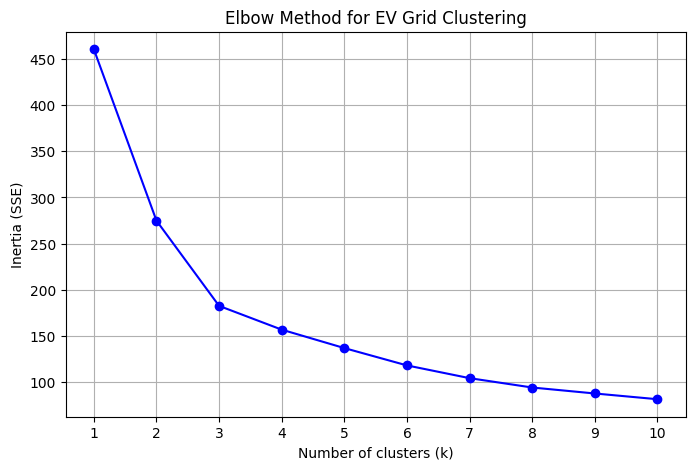

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from google.colab import files
import io

# 1. 데이터 로드 및 유효 격자 필터링 (사용자 파일 업로드)
print("분석할 CSV 파일을 선택해주세요.")
uploaded = files.upload()
file_name = list(uploaded.keys())[0]

df = pd.read_csv(io.BytesIO(uploaded[file_name]), encoding='utf-8-sig', dtype=object)

# 'exclude' 열을 숫자로 변환 후, 1이 아닌(0인) 유효 데이터만 추출
df['exclude'] = pd.to_numeric(df['exclude'], errors='coerce').fillna(0)
df_valid = df[df['exclude'] != 1].copy()

# 2. 분석에 사용할 5개 핵심 지표
features = ['s_population', 's_poi', 's_poi_spatial', 's_capacity_lack', 's_pop_per_charger']

# 모든 feature 열을 숫자형으로 변환 (NaN은 0으로 채움)
for col in features:
    df_valid[col] = pd.to_numeric(df_valid[col], errors='coerce').fillna(0)

# 3. K 값을 1부터 10까지 변화시키며 SSE 계산
sse = []
k_range = range(1, 11)

for k in k_range:
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
    kmeans.fit(df_valid[features])
    sse.append(kmeans.inertia_) # inertia_가 곧 SSE입니다.

# 4. 엘보우 그래프 시각화
plt.figure(figsize=(8, 5))
plt.plot(k_range, sse, marker='o', color='b')
plt.title('Elbow Method for EV Grid Clustering')
plt.xlabel('Number of clusters (k)')
plt.ylabel('Inertia (SSE)')
plt.xticks(k_range)
plt.grid(True)
plt.show()

In [ ]:
# ==========================================
# 5. 시각화 및 최적 입지 색칠 (확실한 버전)
# ==========================================
# 배경 지도를 밝은 톤으로 설정
m = folium.Map(location=[37.6, 127.05], zoom_start=12, tiles='cartodbpositron')

# 1. [기본] 전체 격자망 (회색 테두리, 투명한 배경)
folium.GeoJson(
    final_grid_data,
    name='동북권 전체 격자망',
    style_function=lambda x: {
        'fillColor': '#ffffff00',
        'color': 'gray',
        'weight': 0.5,
        'fillOpacity': 0
    }
).add_to(m)

# 2. [핵심] 최적 후보지 색칠 (df_valid 점수 기반)
# 분석 데이터(df_valid)와 지리 정보(grid_gdf) 병합
df_final_geo = df_valid.merge(grid_gdf[['grid_id', 'geometry']], on='grid_id', how='left')

# 급속 Top 3 (빨간색으로 진하게 칠하기)
top3_fast = df_final_geo.nlargest(3, 'fast_score')
for _, row in top3_fast.iterrows():
    folium.GeoJson(
        row['geometry'].__geo_interface__,
        style_function=lambda x: {
            'fillColor': 'red',
            'color': 'darkred',
            'weight': 3,
            'fillOpacity': 0.7  # 투명도를 높여서 확실히 보이게 함
        },
        tooltip=f"<b>[급속 최적지]</b><br>ID: {row['grid_id']}<br>Score: {row['fast_score']:.2f}"
    ).add_to(m)

# 완속 Top 3 (파란색으로 진하게 칠하기)
top3_slow = df_final_geo.nlargest(3, 'slow_score')
for _, row in top3_slow.iterrows():
    folium.GeoJson(
        row['geometry'].__geo_interface__,
        style_function=lambda x: {
            'fillColor': 'blue',
            'color': 'darkblue',
            'weight': 3,
            'fillOpacity': 0.7
        },
        tooltip=f"<b>[완속 최적지]</b><br>ID: {row['grid_id']}<br>Score: {row['slow_score']:.2f}"
    ).add_to(m)

# 3. 기존 충전소 마커 (Clustering 적용)
marker_cluster = plugins.MarkerCluster(name="기존 충전소").add_to(m)
for _, row in stations_gdf.iterrows():
    color = 'red' if row['speed_label'] == '급속' else 'blue'
    if not row['is_available']: color = 'gray'

    folium.CircleMarker(
        location=[row['lat'], row['lng']],
        radius=3,
        color=color,
        fill=True,
        fill_opacity=0.7,
        tooltip=f"<b>{row['statNm']}</b> ({row['speed_label']})"
    ).add_to(marker_cluster)

# 4. 범례 추가 (지도에서 바로 확인 가능하도록)
legend_html = '''
     <div style="position: fixed;
     bottom: 50px; left: 50px; width: 150px; height: 120px;
     border:2px solid grey; z-index:9999; font-size:14px;
     background-color:white; opacity: 0.8; border-radius: 5px; padding: 10px;
     ">
     <b>설치 후보지</b> <br>
     <i class="fa fa-square" style="color:red"></i> 급속 Top 3 <br>
     <i class="fa fa-square" style="color:blue"></i> 완속 Top 3 <br>
     <hr style="margin:5px 0">
     <b>기존 충전소</b> <br>
     <i class="fa fa-circle" style="color:red"></i> 급속 &nbsp;
     <i class="fa fa-circle" style="color:blue"></i> 완속
     </div>
     '''
m.get_root().html.add_child(folium.Element(legend_html))

# 5. 최종 출력
m.save('northeast_ev_final_map.html')
m